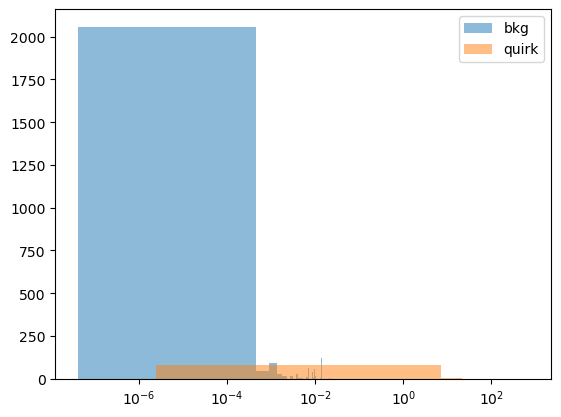

In [7]:
#Draw chi_square value


import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV files into dataframes
df_quirk = pd.read_csv('./output/track_quirk_2000.csv')
df_bkg = pd.read_csv('./output/track_bkg_2000.csv')

# Group the dataframe by 'particle_id' and keep only the first row for each group
#df_reduced_bkg_sel = df_bkg[df_bkg['chi_square_rz'] <= 10].groupby('particle_id').first().reset_index()
#df_reduced_quirk_sel = df_quirk[df_quirk['chi_square_rz'] <= 10].groupby('particle_id').first().reset_index()
df_reduced_bkg = df_bkg.groupby('particle_id').first().reset_index()
df_reduced_quirk = df_quirk.groupby('particle_id').first().reset_index()

# Plot the 'chi-square_rz' column of 'track_bkg.csv' on a log scale with label 'bkg'
plt.hist(df_reduced_bkg['chi_square_rz'], bins=100, alpha=0.5, label='bkg')
#plt.hist(df_reduced_bkg['chi_square_rz'], bins=100, alpha=0.5, label='bkg', density = True)
# Plot the 'chi-square_rz' column of 'track_quirk.csv' on a log scale with label 'quirk'
plt.hist(df_reduced_quirk['chi_square_rz'], bins=100, alpha=0.5, label='quirk')
#plt.hist(df_reduced_quirk['chi_square_rz'], bins=100, alpha=0.5, label='quirk', density = True)
# Add legend to the plot
plt.legend()
# Set x-axis to logarithmic scale
plt.xscale('log')
plt.show()

#plt.hist(df_reduced_bkg_sel['chi_square_rz'], bins=100, alpha=0.5, label='bkg', density = True)
## Plot the 'chi-square_rz' column of 'track_quirk.csv' on a log scale with label 'quirk'
#plt.hist(df_reduced_quirk_sel['chi_square_rz'], bins=100, alpha=0.5, label='quirk', density = True)
## Add legend to the plot
#plt.legend()
#plt.show()

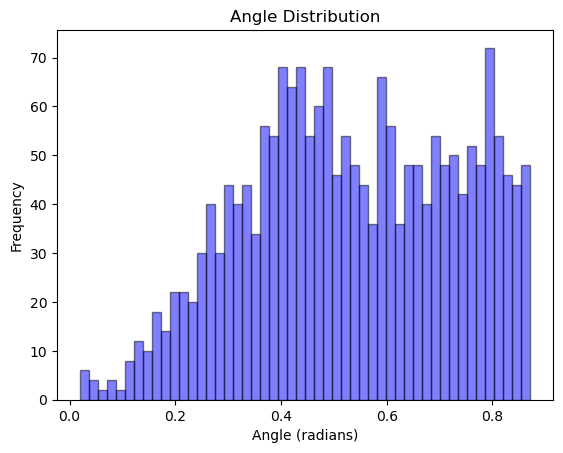

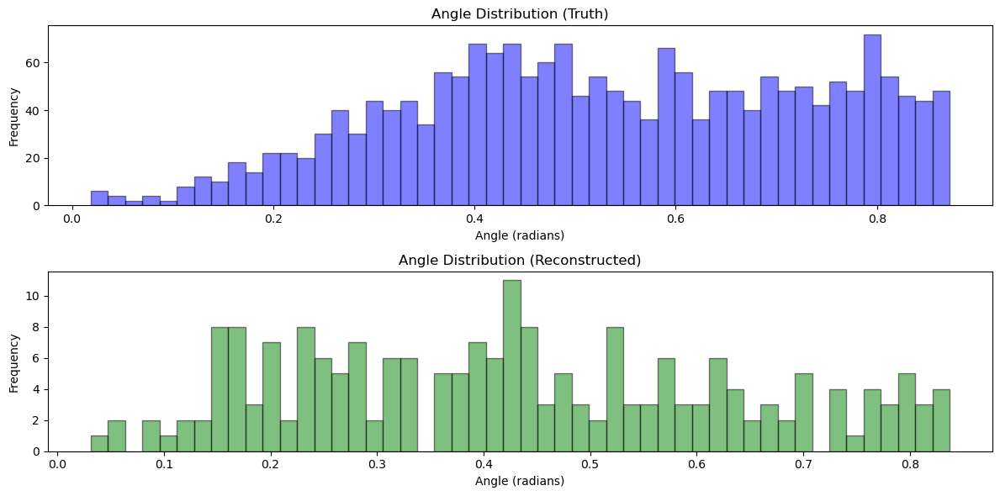

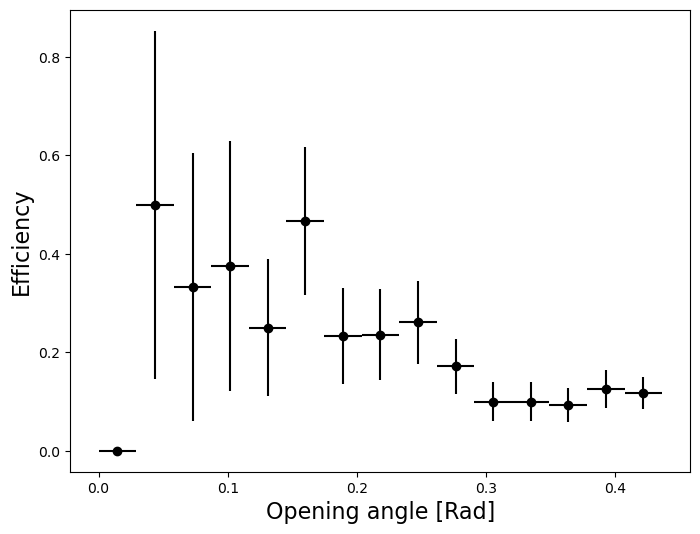

In [16]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math

def get_ratio(x_vals, y_vals):
    res = [x/y if y!=0 else 0.0 for x,y in zip(x_vals, y_vals)]
    err = [x/y * math.sqrt((x+y)/(x*y)) if y!=0 and x!=0 else 0.0 for x,y in zip(x_vals, y_vals)]
    return res, err


# 存储所有文件的角度数据的列表
angle_data = []

# 文件名的起始和结束编号
start_event = 1961
end_event = 8241

# 循环遍历每个文件
for event_number in range(start_event, end_event + 1):
    # 构建文件名
    file_name = f'event{event_number:09d}-particles.csv'
    
    # 构建文件路径
    file_path = os.path.join(f'./datasets/Lambda500_pre_selection_mix_hit/Quirk', file_name)  # 替换your_directory_path为包含CSV文件的文件夹路径
    
    # 检查文件是否存在
    if os.path.exists(file_path):
        # 读取CSV文件并提取angle_radians列
        df = pd.read_csv(file_path)
        angle_data.extend(df['angle_radians'])

# 绘制直方图
plt.hist(angle_data, bins=50, alpha=0.5, color='b', edgecolor='black')
plt.title('Angle Distribution')
plt.xlabel('Angle (radians)')
plt.ylabel('Frequency')
#plt.savefig('./plot/231011/quirk_nosel_2000_1400/angle_plots/val_Angle_Distribution.png')  # 保存第一个图

csv_file = './output/mix/angle_track_mix_quirk_sel_2000_1800.csv'
if os.path.exists(csv_file):
    df = pd.read_csv(csv_file)
    angle_data_csv = df['angle_radians'].tolist()
else:
    angle_data_csv = []

# 绘制两组数据的直方图
plt.figure(figsize=(12, 6))

plt.subplot(2, 1, 1)
plt.hist(angle_data, bins=50, alpha=0.5, color='b', edgecolor='black')
plt.title('Angle Distribution (Truth)')
plt.xlabel('Angle (radians)')
plt.ylabel('Frequency')

plt.subplot(2, 1, 2)
plt.hist(angle_data_csv, bins=50, alpha=0.5, color='g', edgecolor='black')
plt.title('Angle Distribution (Reconstructed)')
plt.xlabel('Angle (radians)')
plt.ylabel('Frequency')

plt.tight_layout()
#plt.savefig('./plot/231011/quirk_nosel_2000_1400/angle_plots/val_Angle_Distribution_Truth_Reconstructed.png')  # 保存第二个图

bins = 15  # bin 的数量
bin_edges = np.linspace(0, 5/36 * np.pi, bins + 1)  # 创建 bin 的边界

# 计算 "event" 数据的直方图
hist_event, true_bins = np.histogram(angle_data, bins=bin_edges)

# 计算 "angle_2000_1200.csv" 文件数据的直方图
hist_csv, reco_bins = np.histogram(angle_data_csv, bins=bin_edges)

eff, err = get_ratio(hist_csv, hist_event)

xvals = (true_bins[1:] + true_bins[:-1]) / 2
xerrs = (true_bins[1:] - true_bins[:-1]) / 2

fig, ax = plt.subplots(figsize=(8, 6))
ax.errorbar(xvals, eff, xerr=xerrs, yerr=err, fmt='o', color='black', label='Efficiency')
# Add x and y labels
ax.set_xlabel('Opening angle [Rad]', fontsize=16)
ax.set_ylabel('Efficiency', fontsize=16)

# Save the plot
fig.savefig('./plot/231008/quirk_mix_sel_2000_1800/quirk/angle_plots/val_Efficiency.png')

# 计算每个 bin 的 ratio
#ratio_data = hist_csv.astype(float) / hist_event.astype(float)
#
## 绘制 ratio 直方图
#plt.figure(figsize=(12, 6))
#plt.bar(bin_edges[:-1], ratio_data, width=(1 * np.pi / bins), align='edge', alpha=0.5, color='r', edgecolor='black')
#plt.title('')
#plt.xlabel('Opening Angle (radians)')
#plt.ylabel('Efficiency')
#plt.savefig('./plot/231011/quirk_nosel_2000_1400/angle_plots/val_Efficiency.png')  # 保存第三个图


In [21]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

data = {'event_number': [], 'angle_radians': [], 'n_true_hits': [], 'truth_pt':[]}

df_quirk = pd.read_csv('./output/track_quirk_sel_2000_1200.csv')
#reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])

n_reconstructed_particles = len(df_quirk.drop_duplicates(subset=['event_id', 'particle_id']))
print(n_reconstructed_particles)

2228


In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

data = {'event_number': [], 'angle_radians': [], 'n_true_hits': [], 'truth_pt':[]}

df_quirk = pd.read_csv('./output/quirk_nosel/track_quirk_sel_2000_1400.csv')
reconstruct_data = df_quirk.drop_duplicates(subset=['event_id', 'particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()
output_directory = './output/quirk_nosel/'  # Change this to your desired directory
result_csv_path = os.path.join(output_directory, 'angle_track_quirk_sel_2000_1400.csv')

# 循环处理每个 event_number
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500_quirk/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # 读取CSV文件并计算角度
    file_particle_name = f"../QuirkTracking/datasets/Lambda500_quirk/Quirk/event00000{event_number}-particles.csv"
    dfp = pd.read_csv(file_particle_name)
    particle1 = dfp.iloc[0][['px', 'py', 'pz']]
    particle2 = dfp.iloc[1][['px', 'py', 'pz']]
    magnitude1 = np.linalg.norm(particle1)
    magnitude2 = np.linalg.norm(particle2)
    cosine_theta = np.dot(particle1, particle2) / (magnitude1 * magnitude2)
    angle_radians = math.acos(cosine_theta)
    angle_degrees = math.degrees(angle_radians)
    #print(f"The angle between two particles in Event {event_number}: degree: {angle_degrees}, rad: {angle_radians}")

    # 获取reconstruct_data的数据
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]
    
    # Get the n_true_hits from the corresponding track_quirk_2000.csv
    n_true_hits = df_reconstruct['n_true_hits'].values[0]
    truth_pt = df_reconstruct['pt'].values[0]

    # Append the data to the DataFrame
    data['n_true_hits'].append(n_true_hits)
    data['angle_radians'].append(angle_radians)
    data['event_number'].append(event_number)
    data['truth_pt'].append(truth_pt)

# Create a DataFrame from the collected data
result_df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
result_df.to_csv(result_csv_path, index=False)

print("Data saved to test.csv")


Data saved to test.csv


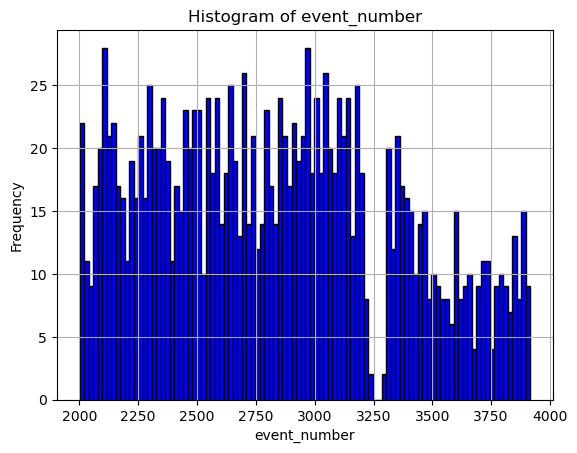

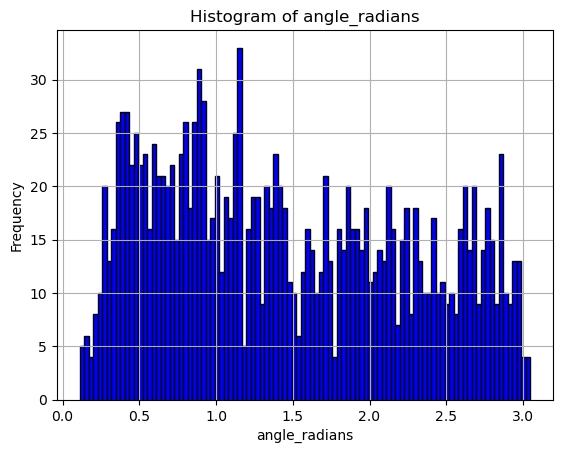

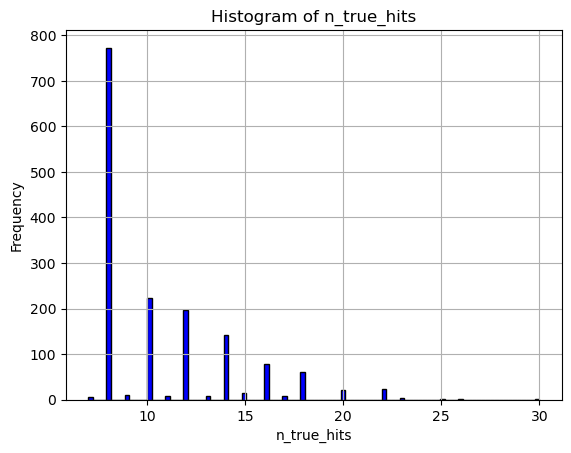

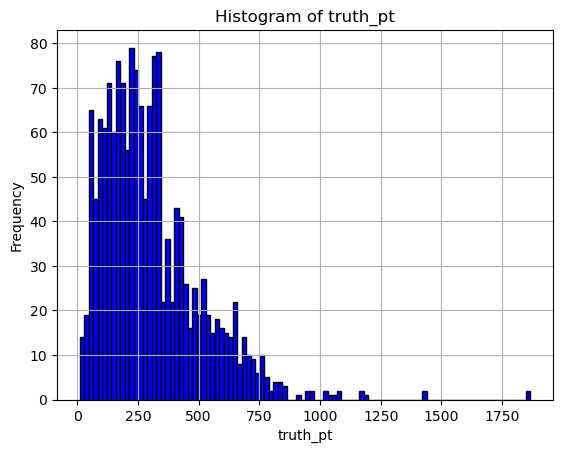

In [9]:
import matplotlib.pyplot as plt
import pandas as pd
import os  # 导入os模块

# 读取数据
df_quirk = pd.read_csv('./output/quirk_nosel/angle_track_quirk_sel_2000_1400.csv')
reconstruct_data_reduce = df_quirk

# 创建用于保存图形的目录
output_directory = './plot/231011/quirk_nosel_2000_1400/angle_plots/'  # 指定目录
os.makedirs(output_directory, exist_ok=True)  # 创建目录，如果不存在则创建

for column_name in reconstruct_data_reduce.columns:
    column_data = reconstruct_data_reduce[column_name]
    
    plt.hist(column_data, bins=100, color='blue', edgecolor='black')
    #plt.xlim(0, 20)
    plt.xlabel(column_name)
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {column_name}')
    
    plt.grid(True)
    
    # 生成文件名
    output_file_path = os.path.join(output_directory, f'histogram_{column_name}.png')
    
    # 保存图形
    plt.savefig(output_file_path)
    
    plt.show()


In [24]:
import torch
import csv
import os

# 加载数据
file_path = "./datasets/Lambda500_pre_selection_quirk/feature_store/QuirkTracking_sample/1007"
if os.path.exists(file_path):
    graph = torch.load(file_path, map_location="cpu")
    print(graph)
else:
    raise FileNotFoundError(f"File not found: {file_path}")

r = graph.x[:, 0].detach().numpy()
phi = graph.x[:, 1].detach().numpy()
z = graph.x[:, 2].detach().numpy()
particle_id = graph.pid.detach().numpy()
event_id = graph.event_file[-4:]  
x = r * np.cos(phi)
y = r * np.sin(phi)

import torch

# 假设graph.modulewise_true_edges是一个PyTorch张量
tensor_value = graph.modulewise_true_edges

# 获取从第0列到第13列的所有值
columns_0_to_13_values = tensor_value[:, 0:14]  # 切片包括0列到13列（14列之前的列）

print("Columns 0 to 13 Values:")
print(columns_0_to_13_values)


# 将r、phi、z、particle_id和event_id的值组合成一个列表
data = list(zip(r, phi, z, particle_id, x, y))

# 动态生成CSV文件名
csv_file_path = "1.csv"

# 打开CSV文件并写入数据
with open(csv_file_path, mode='w', newline='') as csv_file:
    writer = csv.writer(csv_file, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)

    # 写入CSV文件的标题行
    writer.writerow(['r', 'phi', 'z', 'particle_id', 'x', 'y'])

    # 写入数据行
    for row in data:
        writer.writerow(row)

print(f'Data has been written to {csv_file_path}')

Data(x=[16, 3], pid=[16], event_file='datasets/Lambda500_pre_selection_quirk/Quirk/event000001007', hid=[16], pt=[16], modulewise_true_edges=[2, 14], layerwise_true_edges=[2, 14])
Columns 0 to 13 Values:
tensor([[ 0,  1,  2,  3,  4,  5,  6,  8,  9, 10, 11, 12, 13, 14],
        [ 1,  2,  3,  4,  5,  6,  7,  9, 10, 11, 12, 13, 14, 15]])
Data has been written to 1.csv


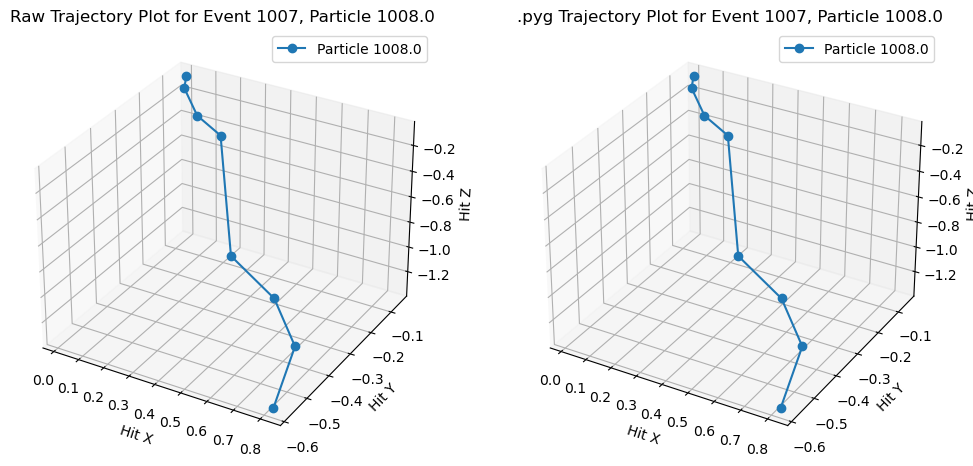

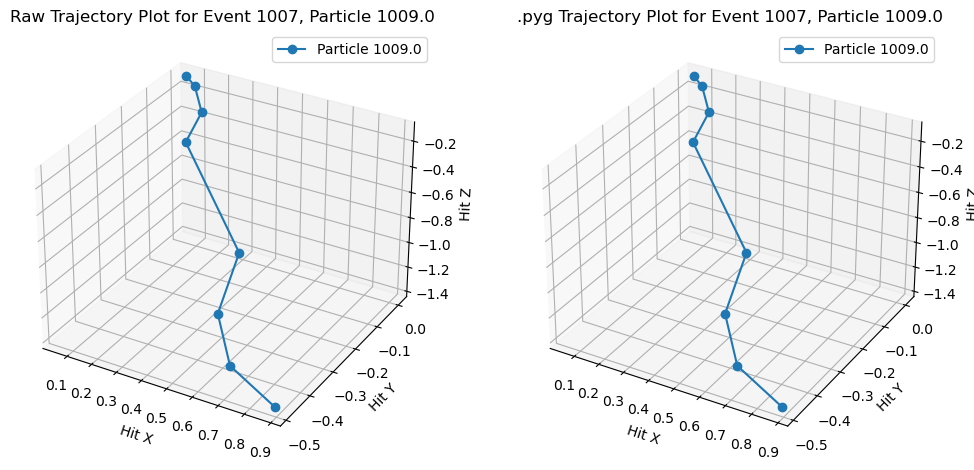

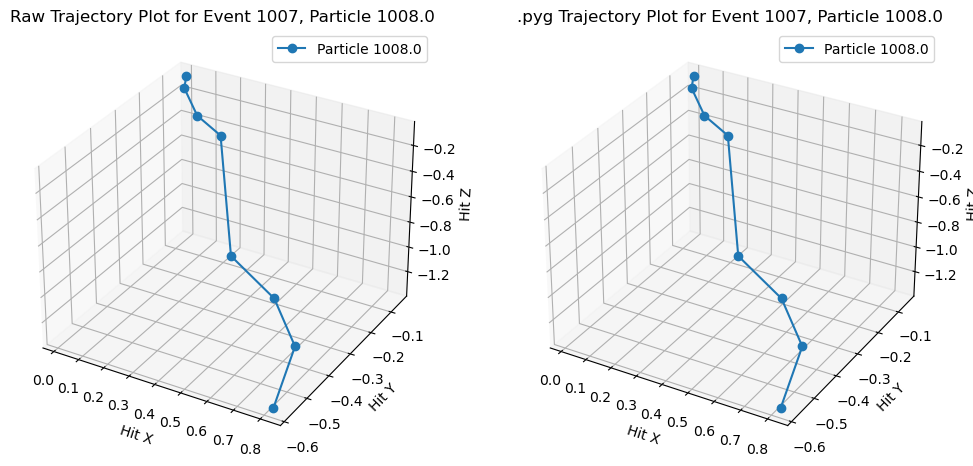

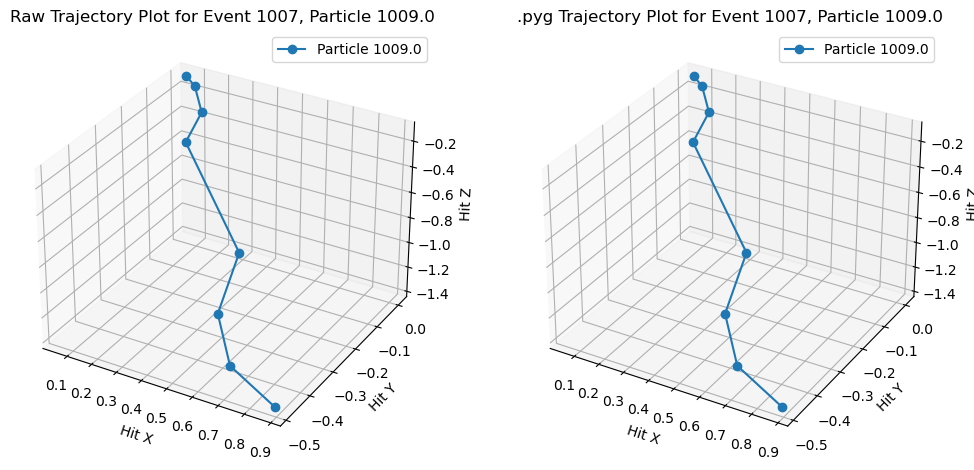

In [28]:
#Draw raw/reco plots

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

output_directory = './plot/quirk_compare_event_id_0930'
os.makedirs(output_directory, exist_ok=True)

def plot_individual_trajectories(df, event_number, df_reconstruct):
    grouped_data = df.groupby('particle_id')
    grouped_reco = df_reconstruct.groupby('particle_id')
    
    # 获取原始数据中的所有不同的particle_id
    particle_ids = df['particle_id'].unique()

    for particle_id in particle_ids:
        fig = plt.figure(figsize=(12, 6))

        # 添加两个子图，一个用于原始数据，一个用于reconstruct_data
        ax1 = fig.add_subplot(121, projection='3d')
        ax2 = fig.add_subplot(122, projection='3d')

        # 绘制原始数据的轨迹
        if particle_id in grouped_data.groups:
            group = grouped_data.get_group(particle_id)
            x = group['x']
            y = group['y']
            z = group['z']
            ax1.plot(x, y, z, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax1.set_xlabel('Hit X')
            ax1.set_ylabel('Hit Y')
            ax1.set_zlabel('Hit Z')
            ax1.set_title(f'Raw Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax1.legend()

        # 绘制reconstruct_data的轨迹
        if particle_id in grouped_reco.groups:
            group_reco = grouped_reco.get_group(particle_id)
            x_recon = group_reco['x']
            y_recon = group_reco['y']
            z_recon = group_reco['z']
            ax2.plot(x_recon, y_recon, z_recon, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax2.set_xlabel('Hit X')
            ax2.set_ylabel('Hit Y')
            ax2.set_zlabel('Hit Z')
            ax2.set_title(f'.pyg Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax2.legend()

        output_file_path = os.path.join(output_directory, f'E{event_number}_Pid{particle_id}.png')
        plt.savefig(output_file_path)
        
        #plt.show()
        
        
df_quirk = pd.read_csv('./1.csv')
reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()[:40]
# 循环处理每个 event_number
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500_pre_selection_quirk/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # 获取reconstruct_data的数据
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]

    # 为每个particle_id创建原始轨迹和重建轨迹的子图
    plot_individual_trajectories(df, event_number, df_reconstruct)

In [10]:
import matplotlib.pyplot as plt
import pandas as pd
import os

df_quirk = pd.read_csv('./output/quirk_nosel/track_quirk_sel_2000_1400.csv')

output_directory = './plot/231011/quirk_nosel_2000_1400/quirk_parameter'
os.makedirs(output_directory, exist_ok=True)

for column_name in df_quirk.columns:
    column_data = df_quirk[column_name]
    
    plt.hist(column_data, bins=100, color='blue', edgecolor='black')
    #plt.xlim(0, 20)
    plt.xlabel(column_name)
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {column_name}')
    
    plt.grid(True)
    
    output_file_path = os.path.join(output_directory, f'{column_name}_histogram.png')
    
    plt.savefig(output_file_path)
    
    plt.clf()

plt.show()

<Figure size 640x480 with 0 Axes>

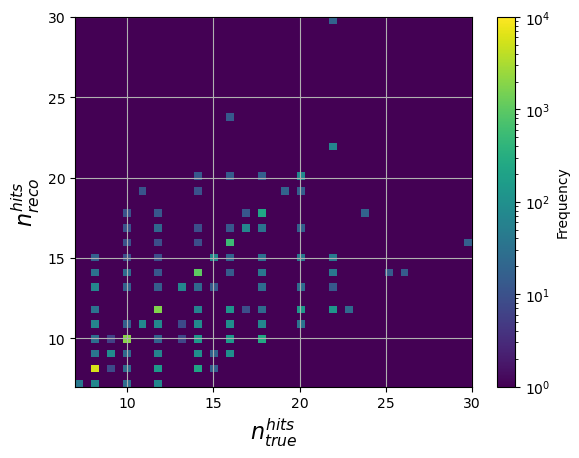

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


[ 7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18. 19. 20. 21. 22. 23. 24.
 25. 26. 27. 28. 29. 30.]
[ 7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18. 19. 20. 21. 22. 23. 24.
 25. 26. 27. 28. 29. 30.]


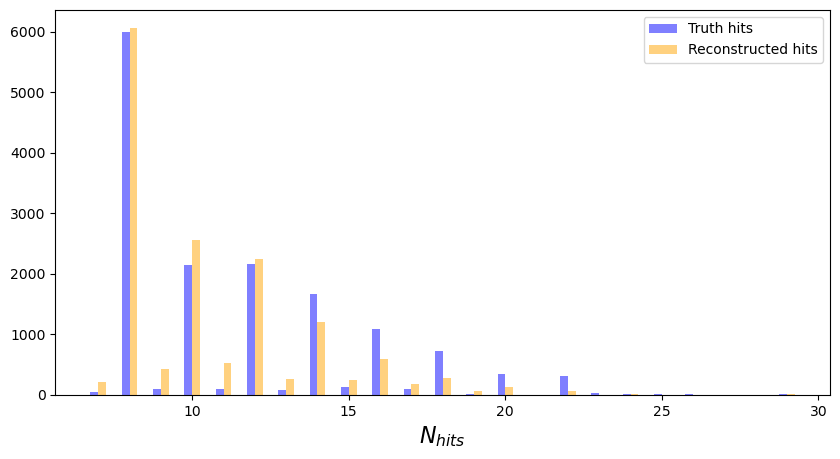

In [37]:
import matplotlib.pyplot as plt
import pandas as pd
import os
import numpy as np
from matplotlib.colors import LogNorm

# 读取 CSV 文件
df_quirk = pd.read_csv('./output/quirk_nosel/track_quirk_sel_2000_1400.csv')

# 创建输出目录
output_directory = './plot/231011/quirk_nosel_2000_1400/quirk_parameter'
os.makedirs(output_directory, exist_ok=True)

# 提取 n_true_hits 和 n_reco_hits 列数据
n_true_hits = df_quirk['n_true_hits']
n_reco_hits = df_quirk['n_reco_hits']

# 计算频率
hist2d, xedges, yedges = np.histogram2d(n_true_hits, n_reco_hits, bins=(50, 50))

# 将频率为0的值替换为1，以避免log(0)错误
hist2d[hist2d == 0] = 1

# 自定义颜色映射和颜色范围
cmap = plt.get_cmap('viridis')
norm = LogNorm(vmin=1, vmax=10000)  # 自定义频率范围

# 绘制二维直方图并按频率着色
plt.imshow(hist2d.T, extent=[xedges.min(), xedges.max(), yedges.min(), yedges.max()], cmap=cmap, norm=norm, origin='lower', aspect='auto')
plt.colorbar(label='Frequency')

plt.xlabel('$n_{true}^{hits}$', fontsize = 16)
plt.ylabel('$n_{reco}^{hits}$', fontsize = 16)
plt.title('')
plt.grid(True)

output_path = os.path.join(output_directory, 'true_reco_compare_2D.png')
plt.savefig(output_path)
plt.show()

######################

# 计算直方图数据
n_bins = 50
n_true_hits_freq, n_true_hits_bins = np.histogram(n_true_hits, bins=23)
n_reco_hits_freq, n_reco_hits_bins = np.histogram(n_reco_hits, bins=23)
print(n_true_hits_bins)
print(n_reco_hits_bins)
# 获取 bin 宽度
#bin_width = n_reco_hits_bins[1] - n_reco_hits_bins[0]
#print(bin_width)
# 缩小 bin 宽度为原来的一半
new_bin_width = 0.25

# 创建图例
plt.figure(figsize=(10, 5))
plt.legend()

# 设置标题和标签
plt.title("")
plt.xlabel("$N_{hits}$", fontsize = 16)
plt.ylabel("")

# 显示图形
plt.bar(n_true_hits_bins[:-1]-0.125, n_true_hits_freq, width=new_bin_width, color='blue', alpha=0.5, label='Truth hits')
plt.bar(n_reco_hits_bins[:-1]+0.125 , n_reco_hits_freq, width=new_bin_width, color='orange', alpha=0.5, label='Reconstructed hits')

plt.legend()
output_path = os.path.join(output_directory, 'true_reco_compare.png')
plt.savefig(output_path)
plt.show()


The angle between two particles in Event 1961: degree: 1.8001145257670312, rad: 0.031417925387611
The angle between two particles in Event 1983: degree: 20.455928226918743, rad: 0.3570232991113778
The angle between two particles in Event 1994: degree: 33.93593494395414, rad: 0.592293799514597
The angle between two particles in Event 1994: degree: 33.93593494395414, rad: 0.592293799514597
The angle between two particles in Event 2021: degree: 12.559743120724029, rad: 0.21920887066134195
The angle between two particles in Event 2051: degree: 25.16661360507537, rad: 0.4392402689857651
The angle between two particles in Event 2051: degree: 25.16661360507537, rad: 0.4392402689857651
The angle between two particles in Event 2096: degree: 24.537643053959187, rad: 0.4282626619707044
The angle between two particles in Event 2140: degree: 27.652516387106672, rad: 0.48262745741669827
The angle between two particles in Event 2155: degree: 26.762566898533258, rad: 0.46709490866465253
The angle betw

/tmp/qsha/ipykernel_2021399/2641950570.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 6))


The angle between two particles in Event 2487: degree: 8.615146699638277, rad: 0.15036267545101092
The angle between two particles in Event 2507: degree: 26.8387576503002, rad: 0.46842468814255533
The angle between two particles in Event 2507: degree: 26.8387576503002, rad: 0.46842468814255533
The angle between two particles in Event 2570: degree: 36.94462692141881, rad: 0.6448053806996946
The angle between two particles in Event 2570: degree: 36.94462692141881, rad: 0.6448053806996946
The angle between two particles in Event 2593: degree: 22.140561760573473, rad: 0.38642570096315954
The angle between two particles in Event 2593: degree: 22.140561760573473, rad: 0.38642570096315954
The angle between two particles in Event 2596: degree: 15.685338732887423, rad: 0.2737608051794809
The angle between two particles in Event 2597: degree: 24.24362175937789, rad: 0.4231310223092847
The angle between two particles in Event 2597: degree: 24.24362175937789, rad: 0.4231310223092847
The angle betw

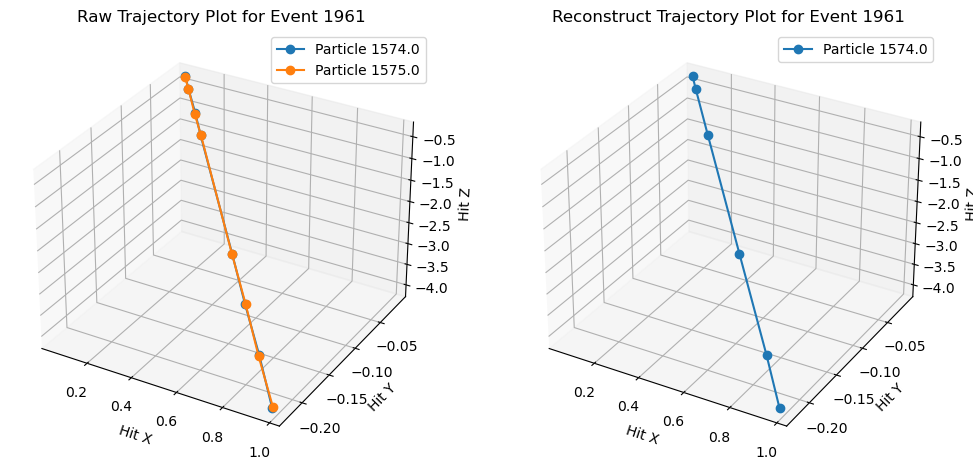

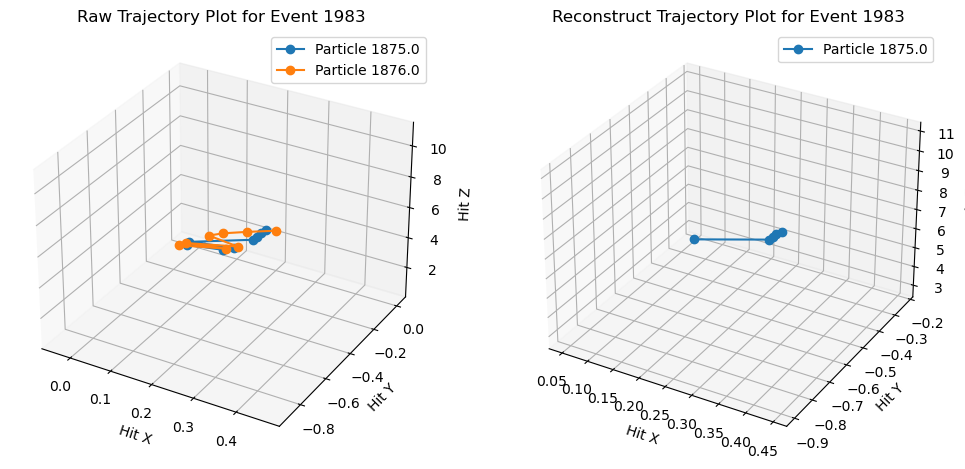

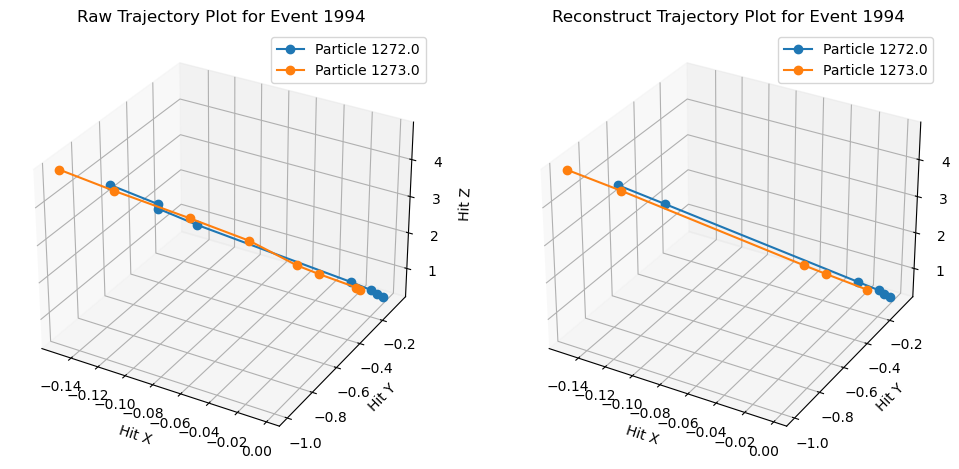

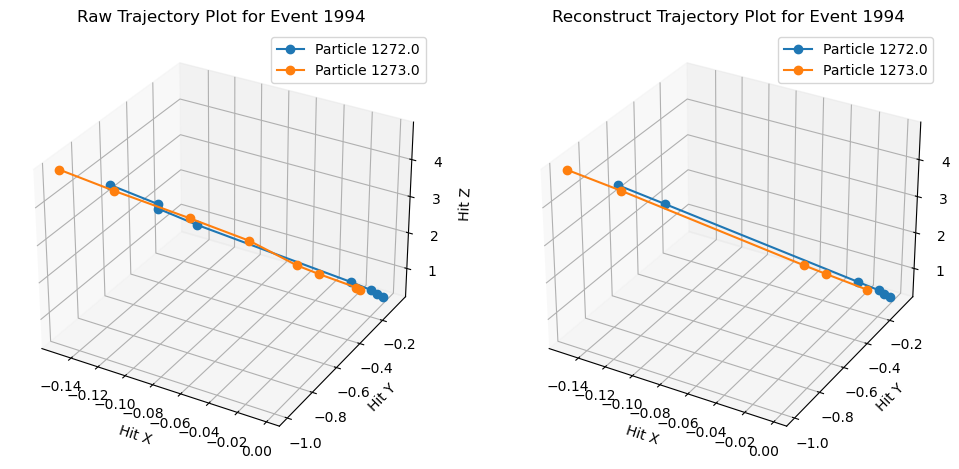

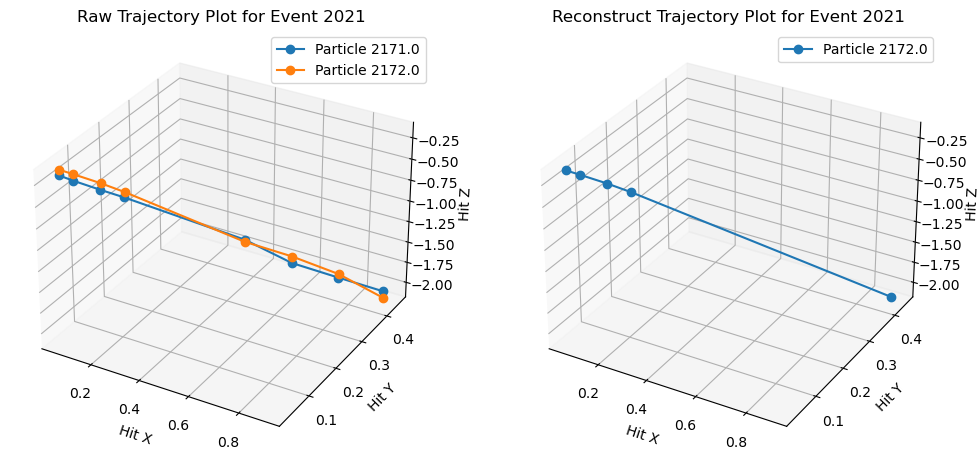

...

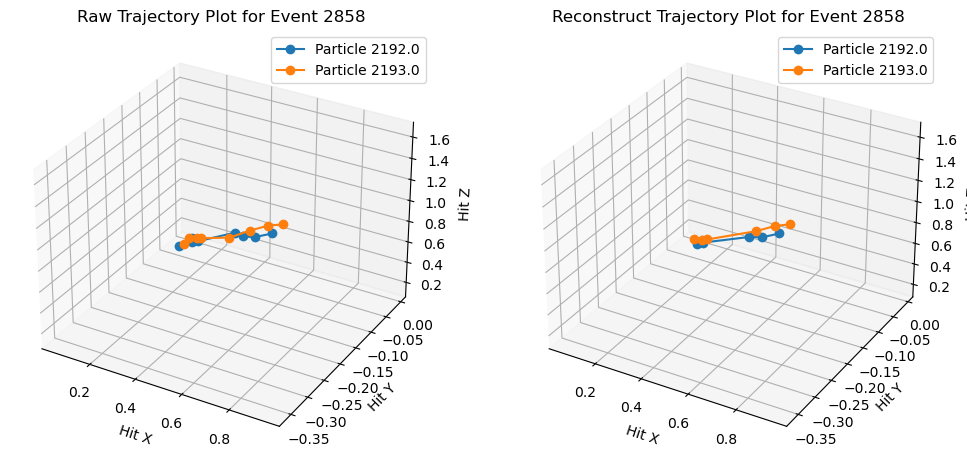

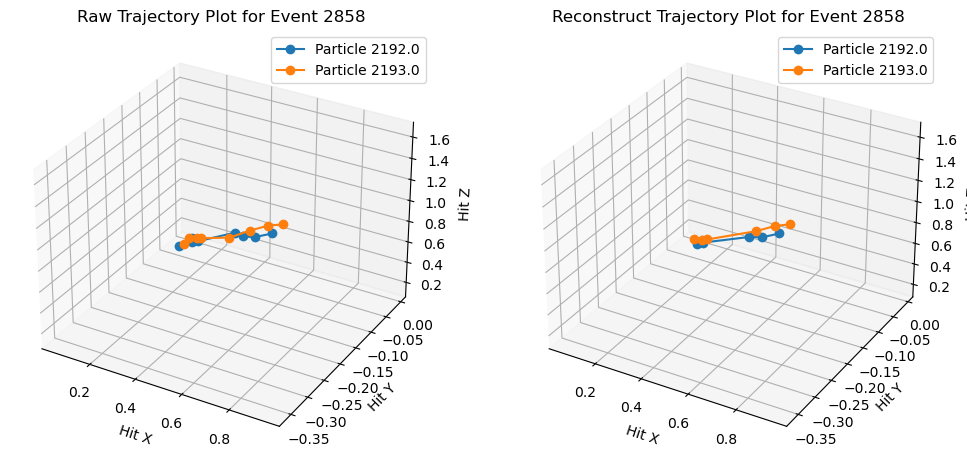

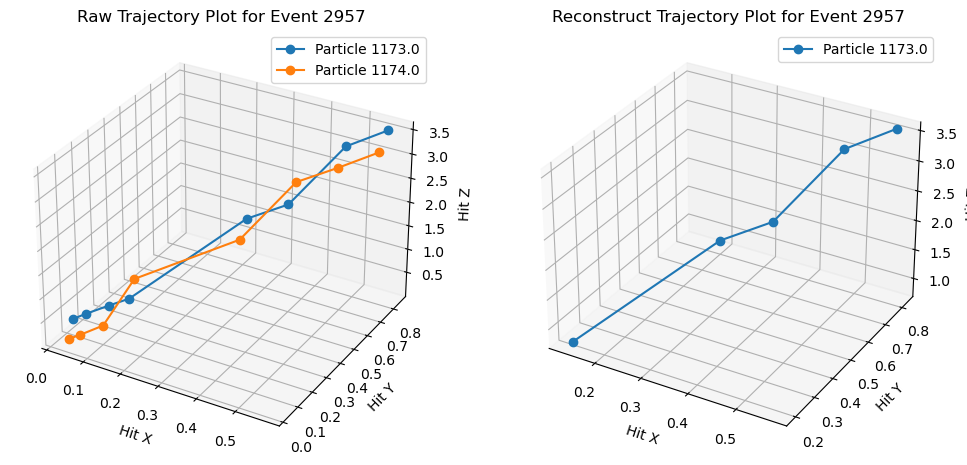

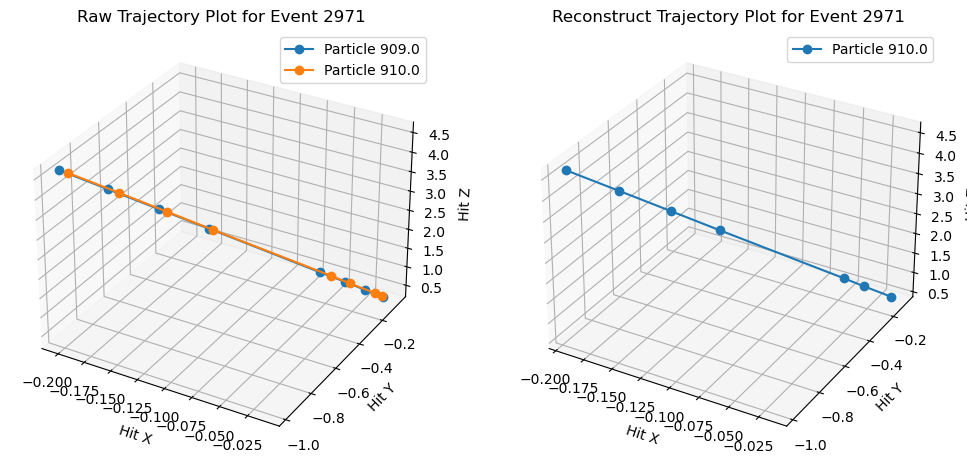

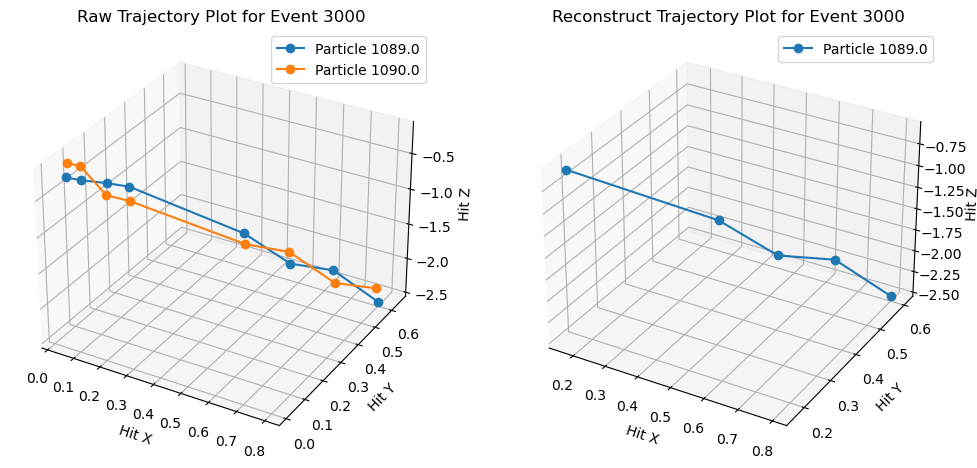

In [1]:
#Draw raw/reco plots

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

output_directory = './plot/231008/quirk_mix_sel_2000_1800/compare_event_id_combine_point'
df_quirk = pd.read_csv('./output/mix/track_mix_quirk_sel_2000_1800.csv')
os.makedirs(output_directory, exist_ok=True)


def plot_event_trajectories(df, event_number, df_reconstruct):
    fig = plt.figure(figsize=(12, 6))
    ax1 = fig.add_subplot(121, projection='3d')
    ax2 = fig.add_subplot(122, projection='3d')

    # Get unique particle_ids for the current event
    particle_ids = df['particle_id'].unique()

    for particle_id in particle_ids:
        # Plot the raw trajectory for each particle
        if particle_id in df['particle_id'].values:
            group = df[df['particle_id'] == particle_id]
            x = group['x']
            y = group['y']
            z = group['z']
            ax1.plot(x, y, z, marker='o', label=f'Particle {particle_id}')
            #ax1.plot(x, y, z, marker='o', linestyle='-', label=f'Particle {particle_id}')

        # Plot the reconstructed trajectory for each particle
        if particle_id in df_reconstruct['particle_id'].values:
            group_reco = df_reconstruct[df_reconstruct['particle_id'] == particle_id]
            x_recon = group_reco['x']
            y_recon = group_reco['y']
            z_recon = group_reco['z']
            ax2.plot(x_recon, y_recon, z_recon, marker='o', label=f'Particle {particle_id}')
            #ax2.plot(x_recon, y_recon, z_recon, marker='o', linestyle='-', label=f'Particle {particle_id}')

    ax1.set_xlabel('Hit X')
    ax1.set_ylabel('Hit Y')
    ax1.set_zlabel('Hit Z')
    ax1.set_title(f'Raw Trajectory Plot for Event {event_number}')
    ax1.legend()

    ax2.set_xlabel('Hit X')
    ax2.set_ylabel('Hit Y')
    ax2.set_zlabel('Hit Z')
    ax2.set_title(f'Reconstruct Trajectory Plot for Event {event_number}')
    ax2.legend()

    output_file_path = os.path.join(output_directory, f'E{event_number}_Trajectories.png')
    plt.savefig(output_file_path)

        
reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()[:40]
# 循环处理每个 event_number
# Loop through each event and plot trajectories for both particles
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500_pre_selection_quirk/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # Read particle data and calculate the angle
    file_particle_name = f"../QuirkTracking/datasets/Lambda500_pre_selection_quirk/Quirk/event00000{event_number}-particles.csv"
    dfp = pd.read_csv(file_particle_name)
    #particle1 = dfp.iloc[0][['px', 'py', 'pz']]
    #particle2 = dfp.iloc[1][['px', 'py', 'pz']]
    #magnitude1 = np.linalg.norm(particle1)
    #magnitude2 = np.linalg.norm(particle2)
    #cosine_theta = np.dot(particle1, particle2) / (magnitude1 * magnitude2)
    #angle_radians = math.acos(cosine_theta)
    #angle_degrees = math.degrees(angle_radians)
    #print(f"The angle between two particles in Event {event_number}: degree: {angle_degrees}, rad: {angle_radians}")

    # Get reconstruction data for the current event
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]

    # Plot trajectories for both particles in the event
    plot_event_trajectories(df, event_number, df_reconstruct)


The angle between two particles in Event 2001: degree: 40.27586212241702, rad: 0.7029464031154484
The angle between two particles in Event 2001: degree: 40.27586212241702, rad: 0.7029464031154484
The angle between two particles in Event 2002: degree: 100.39034710802845, rad: 1.752142094255064
The angle between two particles in Event 2002: degree: 100.39034710802845, rad: 1.752142094255064
The angle between two particles in Event 2003: degree: 125.75818405176614, rad: 2.194894373032342
The angle between two particles in Event 2003: degree: 125.75818405176614, rad: 2.194894373032342
The angle between two particles in Event 2006: degree: 37.73589931306767, rad: 0.6586156892140973
The angle between two particles in Event 2006: degree: 37.73589931306767, rad: 0.6586156892140973
The angle between two particles in Event 2010: degree: 89.5403101855666, rad: 1.562773225995152
The angle between two particles in Event 2010: degree: 89.5403101855666, rad: 1.562773225995152
The angle between two pa

/tmp/qsha/ipykernel_2021399/2496545454.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 6))


The angle between two particles in Event 2011: degree: 65.4356234943799, rad: 1.1420670780722864
The angle between two particles in Event 2012: degree: 28.947419213664567, rad: 0.5052277752335146
The angle between two particles in Event 2012: degree: 28.947419213664567, rad: 0.5052277752335146
The angle between two particles in Event 2013: degree: 66.16128070586105, rad: 1.1547321856534731
The angle between two particles in Event 2013: degree: 66.16128070586105, rad: 1.1547321856534731
The angle between two particles in Event 2014: degree: 172.74933038052637, rad: 3.015044595755654
The angle between two particles in Event 2014: degree: 172.74933038052637, rad: 3.015044595755654
The angle between two particles in Event 2015: degree: 24.22830918111275, rad: 0.4228637674015886
The angle between two particles in Event 2015: degree: 24.22830918111275, rad: 0.4228637674015886
The angle between two particles in Event 2016: degree: 25.69937640430476, rad: 0.4485387339644595
The angle between t

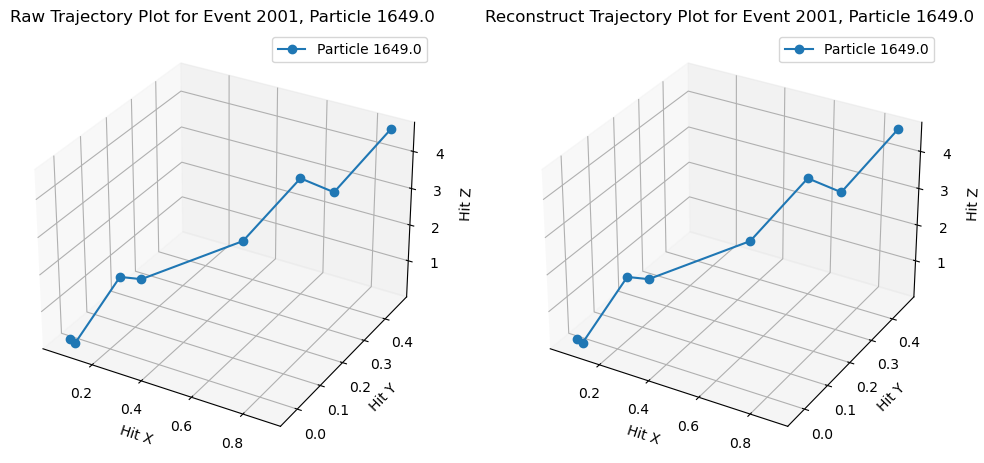

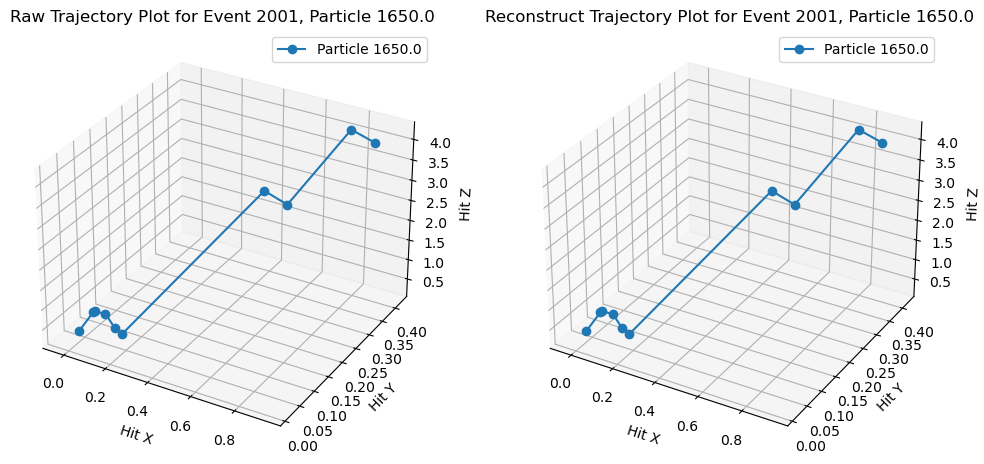

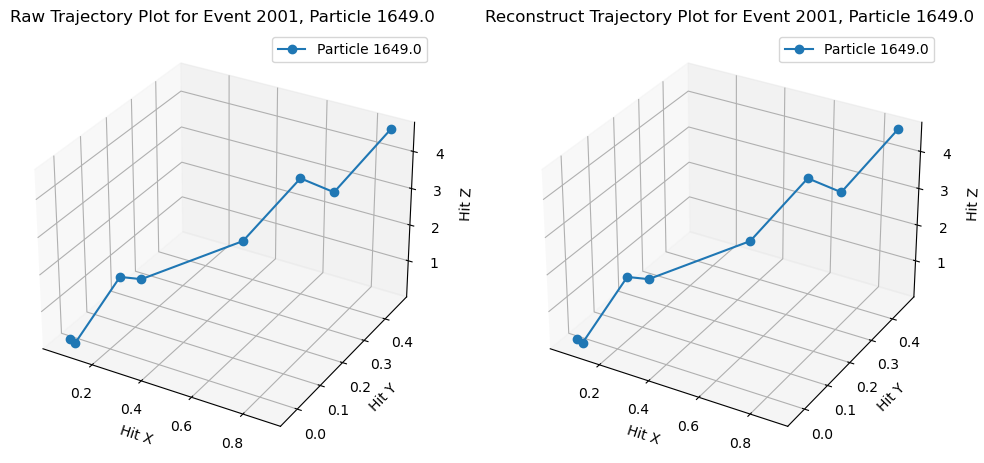

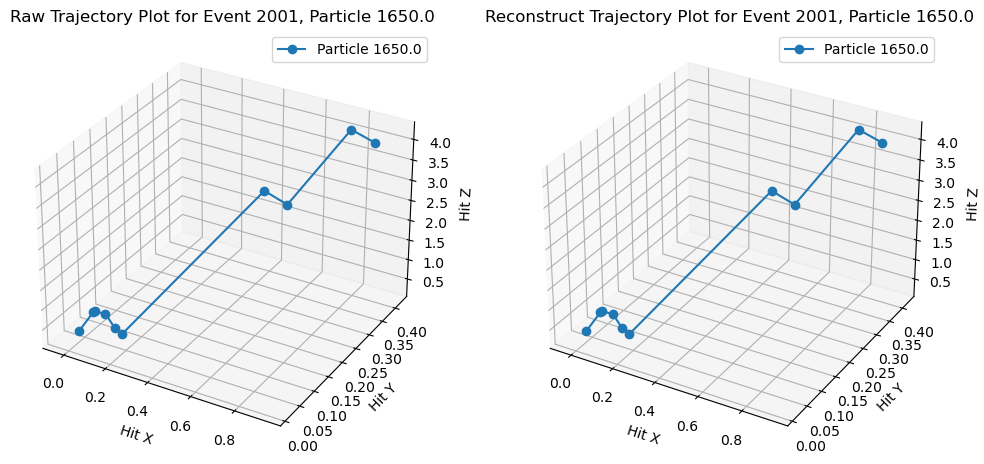

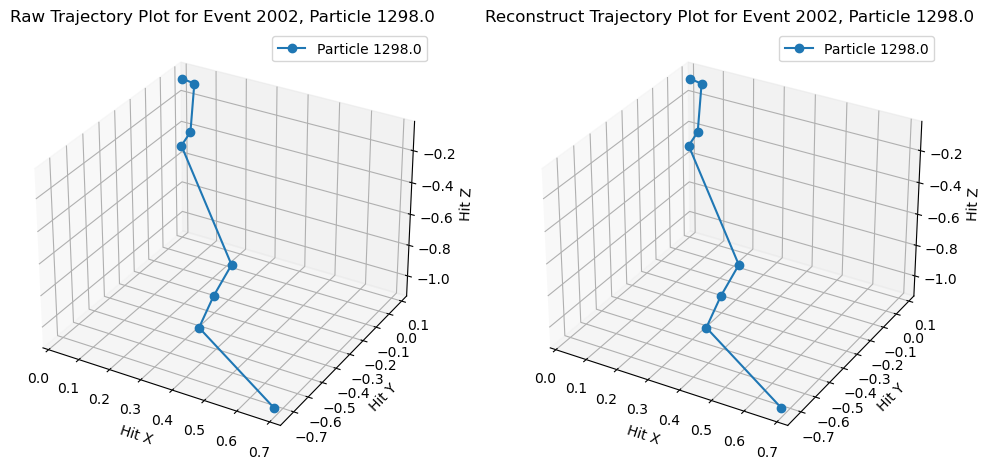

...

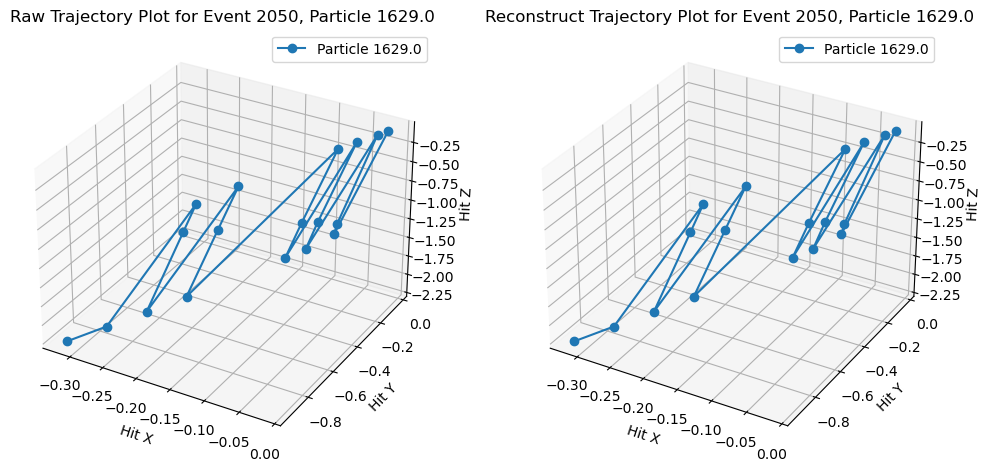

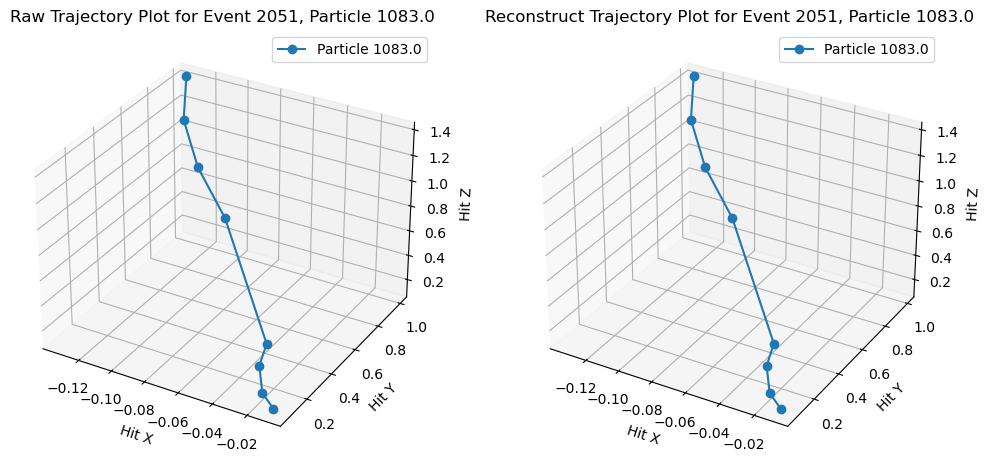

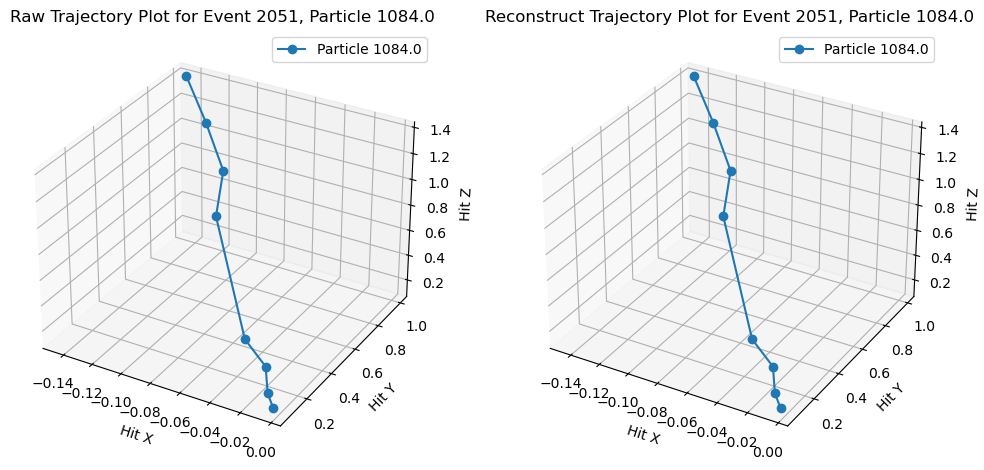

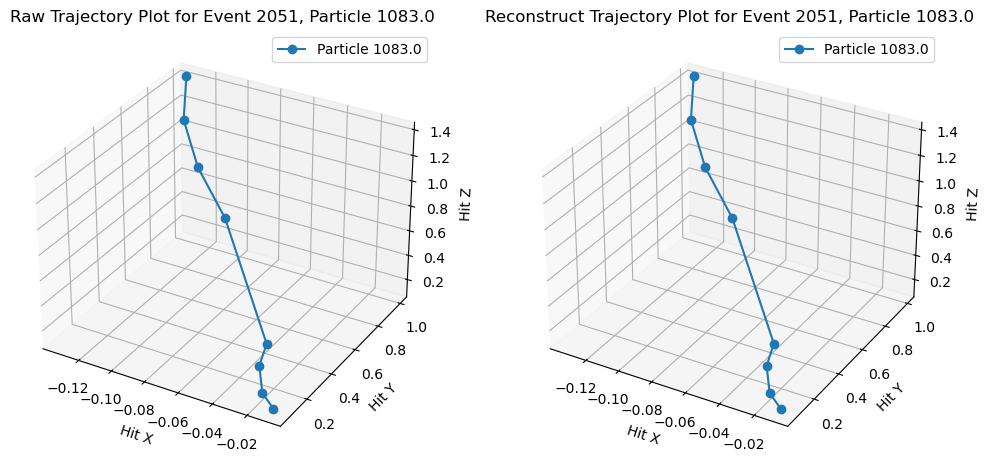

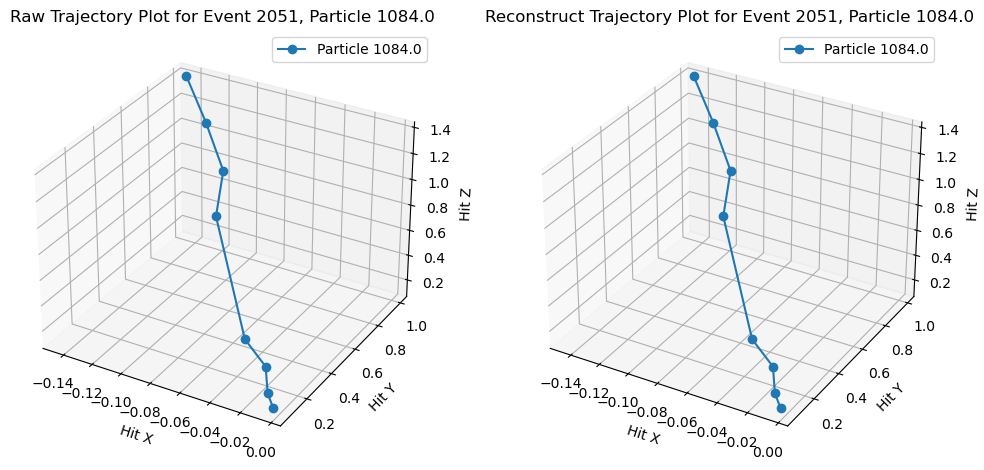

In [2]:
#Draw raw/reco plots

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import math
import os

output_directory = './plot/231011/quirk_nosel_2000_1400/compare_event_id_point'
df_quirk = pd.read_csv('./output/quirk_nosel/track_quirk_sel_2000_1400.csv')
os.makedirs(output_directory, exist_ok=True)

def plot_individual_trajectories(df, event_number, df_reconstruct):
    grouped_data = df.groupby('particle_id')
    grouped_reco = df_reconstruct.groupby('particle_id')
    
    # 获取原始数据中的所有不同的particle_id
    particle_ids = df['particle_id'].unique()

    for particle_id in particle_ids:
        fig = plt.figure(figsize=(12, 6))

        # 添加两个子图，一个用于原始数据，一个用于reconstruct_data
        ax1 = fig.add_subplot(121, projection='3d')
        ax2 = fig.add_subplot(122, projection='3d')

        # 绘制原始数据的轨迹
        if particle_id in grouped_data.groups:
            group = grouped_data.get_group(particle_id)
            x = group['x']
            y = group['y']
            z = group['z']
            ax1.plot(x, y, z, marker='o', label=f'Particle {particle_id}')
            #ax1.plot(x, y, z, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax1.set_xlabel('Hit X')
            ax1.set_ylabel('Hit Y')
            ax1.set_zlabel('Hit Z')
            ax1.set_title(f'Raw Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax1.legend()

        # 绘制reconstruct_data的轨迹
        if particle_id in grouped_reco.groups:
            group_reco = grouped_reco.get_group(particle_id)
            x_recon = group_reco['x']
            y_recon = group_reco['y']
            z_recon = group_reco['z']
            ax2.plot(x_recon, y_recon, z_recon, marker='o', linestyle='-', label=f'Particle {particle_id}')
            ax2.set_xlabel('Hit X')
            ax2.set_ylabel('Hit Y')
            ax2.set_zlabel('Hit Z')
            ax2.set_title(f'Reconstruct Trajectory Plot for Event {event_number}, Particle {particle_id}')
            ax2.legend()

        output_file_path = os.path.join(output_directory, f'E{event_number}_Pid{particle_id}.png')
        plt.savefig(output_file_path)
        
        #plt.show()
        
        
reconstruct_data = df_quirk.drop_duplicates(subset=['particle_id'])
event_file_array = reconstruct_data['event_id'].to_numpy()[:40]
# 循环处理每个 event_number
for event_number in event_file_array:
    file_hit_name = f"../QuirkTracking/datasets/Lambda500_quirk/Quirk/event00000{event_number}-hits.csv"
    df = pd.read_csv(file_hit_name)
    df['r'] = (df['r']) / 51.4
    df['x'] = (df['r']) * np.cos(df['phi'])
    df['y'] = (df['r']) * np.sin(df['phi'])
    df['z'] = df['z'] / 100.

    # 读取CSV文件并计算角度
    file_particle_name = f"../QuirkTracking/datasets/Lambda500_quirk/Quirk/event00000{event_number}-particles.csv"
    dfp = pd.read_csv(file_particle_name)
    particle1 = dfp.iloc[0][['px', 'py', 'pz']]
    particle2 = dfp.iloc[1][['px', 'py', 'pz']]
    magnitude1 = np.linalg.norm(particle1)
    magnitude2 = np.linalg.norm(particle2)
    cosine_theta = np.dot(particle1, particle2) / (magnitude1 * magnitude2)
    angle_radians = math.acos(cosine_theta)
    angle_degrees = math.degrees(angle_radians)
    print(f"The angle between two particles in Event {event_number}: degree: {angle_degrees}, rad: {angle_radians}")

    # 获取reconstruct_data的数据
    df_reconstruct = df_quirk[df_quirk['event_id'] == event_number]

    # 为每个particle_id创建原始轨迹和重建轨迹的子图
    plot_individual_trajectories(df, event_number, df_reconstruct)
    
    